In [1]:
import pandas as pd
import anndata as ad
from loguru import logger 
import time

import numpy as np
import tifffile

import matplotlib.pyplot as plt
import seaborn as sns

import shapely
import geopandas as gpd

import os
import sys
sys.path.append(os.path.abspath('../scripts'))
import utils
import importlib

import scimap as sm

Running SCIMAP  2.1.3


In [2]:
sample_id = 992

path_to_quant = f"../data/quantification/{sample_id}_backsub_quantification.csv"
path_to_geojson = f"../data/geojsons/{sample_id}.geojson"
# path_to_gates = "../data/phenotyping/20240918_gates.csv"
path_to_phenotype_matrix = "../data/phenotyping/20240905_PhenotypeMatrix_v3.csv"

In [3]:
adata = utils.read_quant(path_to_quant)

2024-10-02 12:21:30.719 | INFO     | utils:read_quant:24 -  ---- read_quant : version number 1.1.0 ----
2024-10-02 12:21:36.622 | INFO     | utils:read_quant:44 -  1134347 cells and 75 variables
2024-10-02 12:21:36.627 | INFO     | utils:read_quant:45 -  ---- read_quant is done, took 5s  ----


2024-10-02 13:30:22.544 | INFO     | utils:filter_by_annotation:170 -  ---- filter_by_annotation : version number 1.2.0 ----
2024-10-02 13:30:22.748 | INFO     | utils:filter_by_annotation:176 - GeoJson loaded, detected: 19 annotations
2024-10-02 13:33:38.065 | INFO     | utils:filter_by_annotation:188 - Labelled cells with annotations if they were found inside
2024-10-02 13:33:38.105 | INFO     | utils:filter_by_annotation:189 - Number of cells not found inside any annotation: 1059244


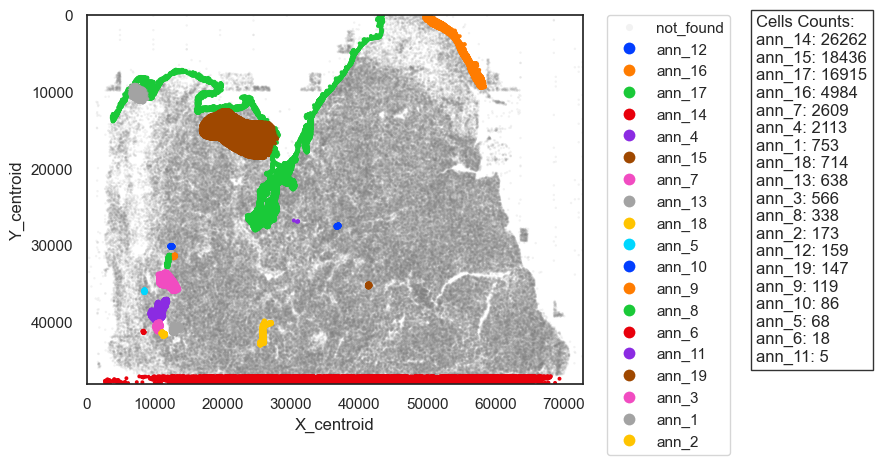

2024-10-02 13:33:39.612 | INFO     | utils:filter_by_annotation:221 -  ---- filter_by_annotation is done, took 197s  ----


In [4]:
adata = utils.filter_by_annotation(adata, path_to_geojson=path_to_geojson)

/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/pandas/core/internals/blocks.py:393: RuntimeWarning:

divide by zero encountered in log10



Threshold for DAPI intensity: 199.53
Threshold for DAPI intensity: 2818.38


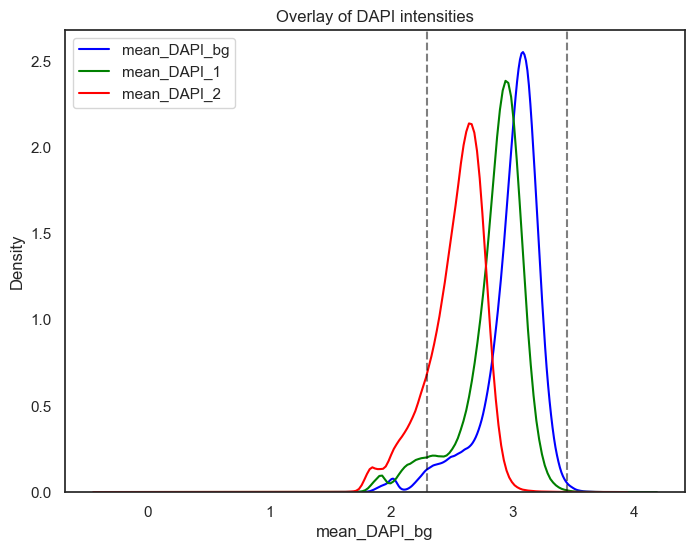

In [5]:
# Plot the density plot for each column
plt.figure(figsize=(8,6))
tmp_df = np.log10(pd.DataFrame(adata.X, columns=adata.var_names))
sns.kdeplot(tmp_df['mean_DAPI_bg'], label='mean_DAPI_bg', color='blue')
sns.kdeplot(tmp_df['mean_DAPI_1'], label='mean_DAPI_1', color='green')
sns.kdeplot(tmp_df['mean_DAPI_2'], label='mean_DAPI_2', color='red')

low_threshold = 2.3
plt.axvline(low_threshold, color='black', linestyle='--', alpha=0.5)
print(f"Threshold for DAPI intensity: {10**low_threshold:.2f}")

high_threshold = 3.45
plt.axvline(high_threshold, color='black', linestyle='--', alpha=0.5)
print(f"Threshold for DAPI intensity: {10**high_threshold:.2f}")

plt.title('Overlay of DAPI intensities')
plt.legend()
plt.show()

2024-10-02 13:34:48.931 | INFO     | utils:filter_by_abs_value:227 -  ---- filter_by_abs_value : version number 1.0.0 ----
2024-10-02 13:34:49.003 | INFO     | utils:filter_by_abs_value:243 - Number of cells with mean_DAPI_bg above 199: 1107908


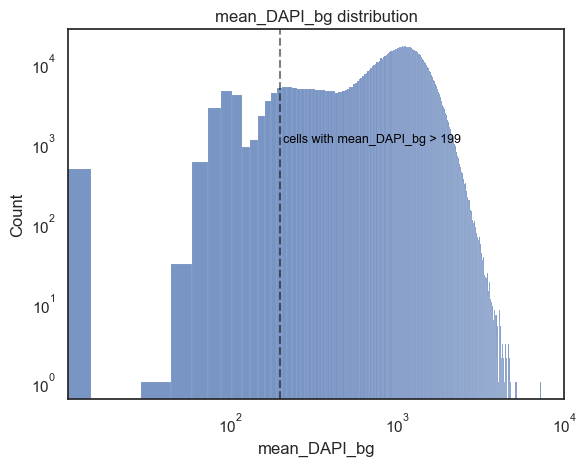

2024-10-02 13:34:49.763 | INFO     | utils:filter_by_abs_value:265 -  ---- filter_by_abs_value is done, took 0s  ----
2024-10-02 13:34:49.764 | INFO     | utils:filter_by_abs_value:227 -  ---- filter_by_abs_value : version number 1.0.0 ----
2024-10-02 13:34:49.803 | INFO     | utils:filter_by_abs_value:248 - Number of cells with mean_DAPI_bg below 2818: 1131162


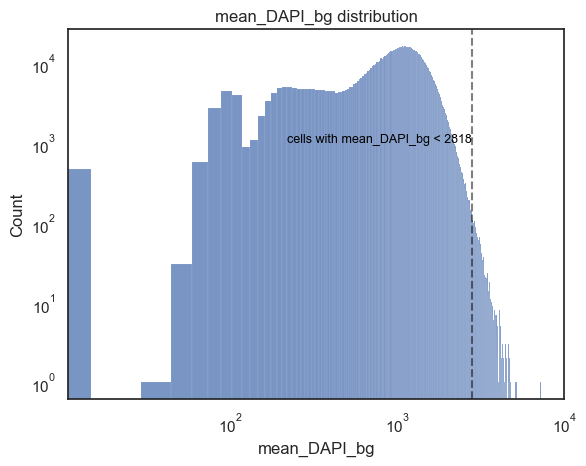

2024-10-02 13:34:50.505 | INFO     | utils:filter_by_abs_value:265 -  ---- filter_by_abs_value is done, took 0s  ----


In [6]:
adata = utils.filter_by_abs_value(adata=adata, marker="mean_DAPI_bg", value=199, direction="above")
adata = utils.filter_by_abs_value(adata=adata, marker="mean_DAPI_bg", value=2818, direction="below")

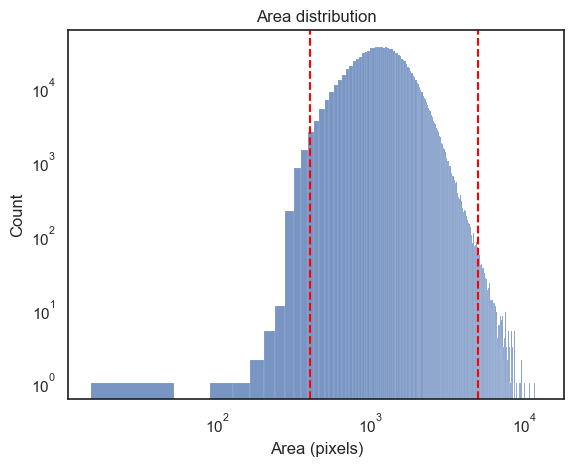

In [63]:
sns.histplot(adata.obs['Area'], bins=350)
plt.yscale('log')
plt.xscale('log')
plt.title('Area distribution')
plt.xlabel('Area (pixels)')
plt.axvline(400, color='red', linestyle='--')
plt.axvline(5000, color='red', linestyle='--')
plt.show()

In [7]:
adata.obs['Area_filter_nottoobig'] = adata.obs['Area'] < 5000
adata.obs['Area_filter_nottoolow'] = adata.obs['Area'] > 400
adata.obs['Area_filter'] = adata.obs['Area_filter_nottoobig'] & adata.obs['Area_filter_nottoolow']

#print stats
print("Number of cells before filtering: ", adata.shape[0])
print("Number of cells filtered out by Area: ", adata.shape[0] - adata.obs['Area_filter'].sum())
print("Percentage of cells filtered out by Area: ", round((adata.shape[0] - adata.obs['Area_filter'].sum())/adata.shape[0]*100, 3), "%")

Number of cells before filtering:  1134347
Number of cells filtered out by Area:  4417
Percentage of cells filtered out by Area:  0.389 %


2024-10-02 13:35:12.190 | INFO     | utils:filter_by_ratio:123 -  ---- filter_by_ratio : version number 1.1.0 ----
2024-10-02 13:35:12.257 | INFO     | utils:filter_by_ratio:141 - Number of cells with DAPI ratio < 0.15: 36285
2024-10-02 13:35:12.296 | INFO     | utils:filter_by_ratio:142 - Number of cells with DAPI ratio > 1.05: 1618
2024-10-02 13:35:12.335 | INFO     | utils:filter_by_ratio:143 - Number of cells with DAPI ratio between 0.15 and 1.05: 1095999
2024-10-02 13:35:12.374 | INFO     | utils:filter_by_ratio:144 - Percentage of cells filtered out: 3.38%


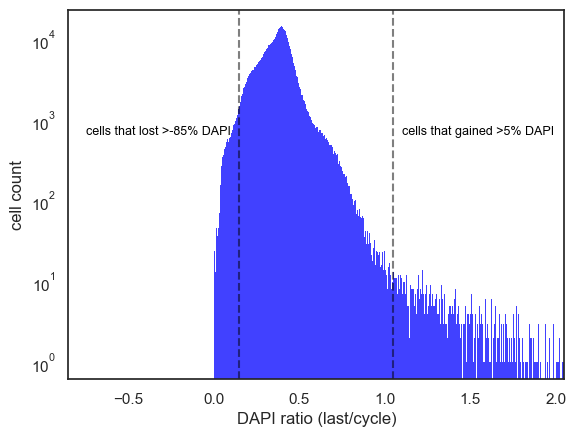

2024-10-02 13:35:15.062 | INFO     | utils:filter_by_ratio:164 -  ---- filter_by_ratio is done, took 2s  ----


In [8]:
adata = utils.filter_by_ratio(
    adata=adata, 
    end_cycle="mean_DAPI_2", 
    start_cycle="mean_DAPI_bg", 
    label="DAPI",
    min_ratio=0.15,
    max_ratio=1.05,
    )

In [9]:
adata = adata[adata.obs['filter_by_ann'].astype(bool) & adata.obs['mean_DAPI_bg_abs_below_value'] & adata.obs['mean_DAPI_bg_abs_above_value'] & adata.obs['Area_filter'] & adata.obs['DAPI_ratio_pass']]

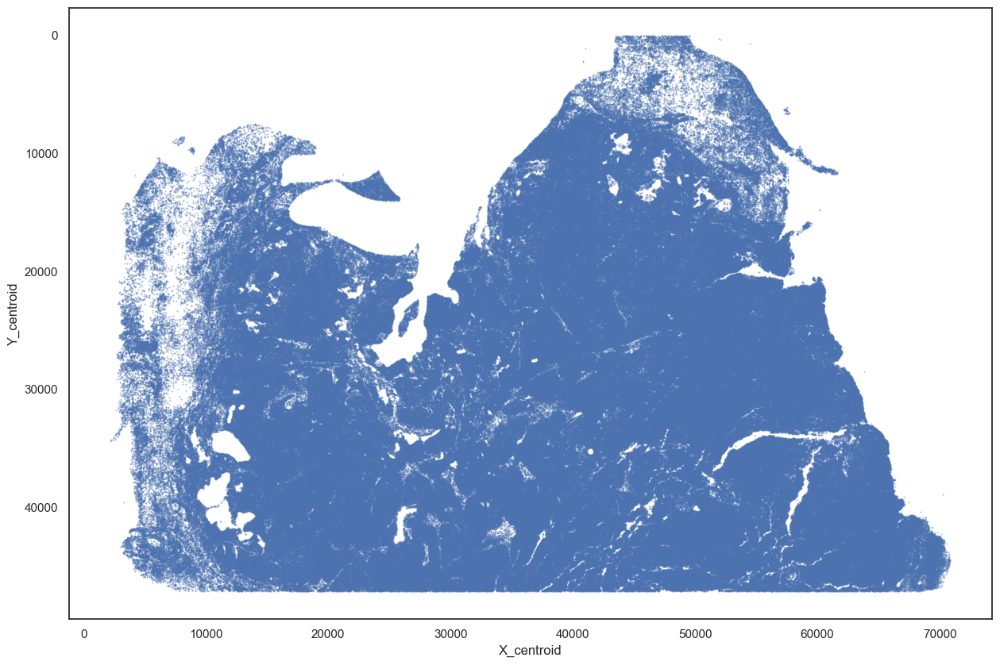

In [10]:
sns.scatterplot(data=adata.obs, x='X_centroid', y='Y_centroid', linewidth=0, s=2, alpha=0.5)
fig = plt.gcf()
fig.set_size_inches(15, 10)
plt.gca().invert_yaxis()
plt.show()

In [11]:
# save clean adata
adata.write(f"../data/processed/20241002_992_clean.h5ad")

/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/anndata/_core/anndata.py:1145: ImplicitModificationWarning:

Trying to modify attribute `.var` of view, initializing view as actual.

/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/anndata/_core/anndata.py:1145: ImplicitModificationWarning:

Trying to modify attribute `.var` of view, initializing view as actual.



# Start Phenotyping

In [32]:
adata = ad.read(f"../data/processed/20241002_992_clean.h5ad")

/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/anndata/__init__.py:55: FutureWarning:

`anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.



## load gates and mod

In [33]:
importlib.reload(utils)
path_to_gates = "../data/phenotyping/20240918_gates.csv"
gates = utils.read_gates(path_to_gates, sample_id=992)

2024-10-02 13:47:32.756 | INFO     | utils:read_gates:50 -  ---- read_gates : version number 1.1.0 ----
2024-10-02 13:47:32.761 | INFO     | utils:read_gates:56 -    Filtering out all rows with value 0.0 (assuming not gated)
2024-10-02 13:47:32.762 | INFO     | utils:read_gates:59 -   Found 79 valid gates
2024-10-02 13:47:32.762 | INFO     | utils:read_gates:60 -   Markers found: ['mean_Vimentin' 'mean_CD3e' 'mean_panCK' 'mean_CD8' 'mean_COL1A1'
 'mean_CD20' 'mean_CD68' 'mean_Ki67']
2024-10-02 13:47:32.764 | INFO     | utils:read_gates:61 -   Samples found: [1000 1002  990  991  992  993  994  997  998  999]
2024-10-02 13:47:32.765 | INFO     | utils:read_gates:66 -   Found 7 valid gates for sample 992
2024-10-02 13:47:32.765 | INFO     | utils:read_gates:68 -  ---- read_gates is done, took 0s  ----


In [34]:
# there is no mean_CD8, because the signal to noise ratio was too low, but I will test manually
# New row data
CD8_row = {'sample_id': 992, 'marker_id': "mean_CD8", 'gate_value': 2500.0}

# Adding the new row using loc
gates.loc[len(gates)] = CD8_row

In [37]:
adata.obs['imageid'] = "992"
adata = adata[:, adata.var_names.isin(gates['marker_id'])]
gates_processed = utils.process_gates_for_sm(gates, sample_id="992")
# save prepared adata for phenotyping
adata.write(f"../data/processed/20241002_992_rdy_for_phenotyping.h5ad")

2024-10-02 13:48:11.297 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 13:48:11.301 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/anndata/_core/anndata.py:1145: ImplicitModificationWarning:

Trying to modify attribute `.obs` of view, initializing view as actual.



2024-10-02 13:48:15.532 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 13:48:15.560 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 13:48:15.561 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 13:48:15.563 | INFO     | utils:phenotype_with_gate_change:305 - processed gate         marker       991
321  mean_CD3e  5.860786
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:100: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is 

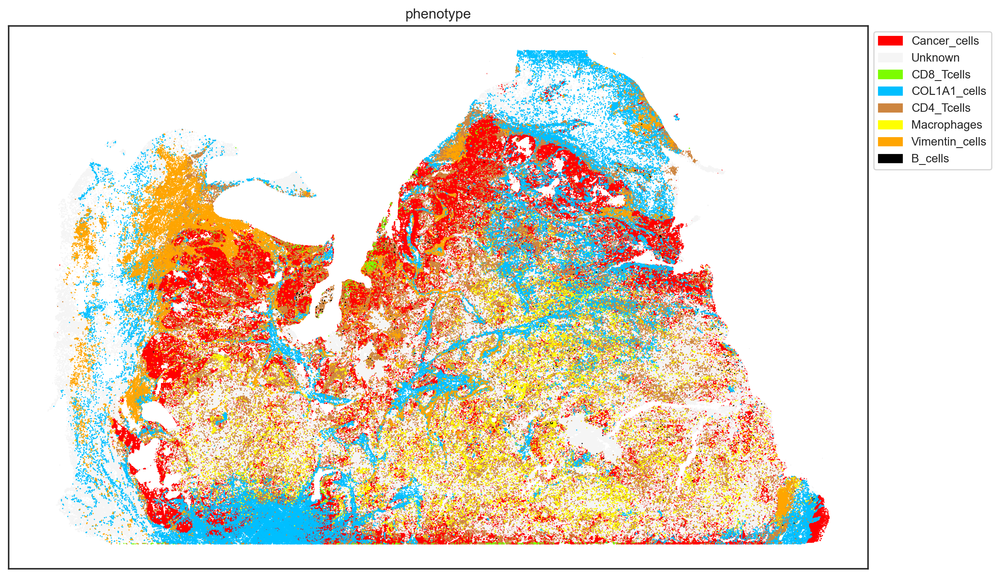

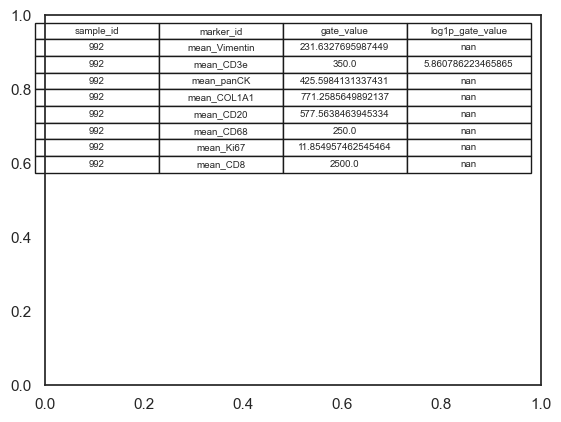

In [38]:
importlib.reload(utils)
utils.phenotype_with_gate_change(
    adata=adata,
    gates=gates,
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_CD3e",
    new_gate = 350
)

2024-10-02 14:02:40.997 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 14:02:41.189 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 14:02:41.190 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 14:02:41.192 | INFO     | utils:phenotype_with_gate_change:305 - processed gate          marker       991
322  mean_panCK  5.929589
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:100: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill i

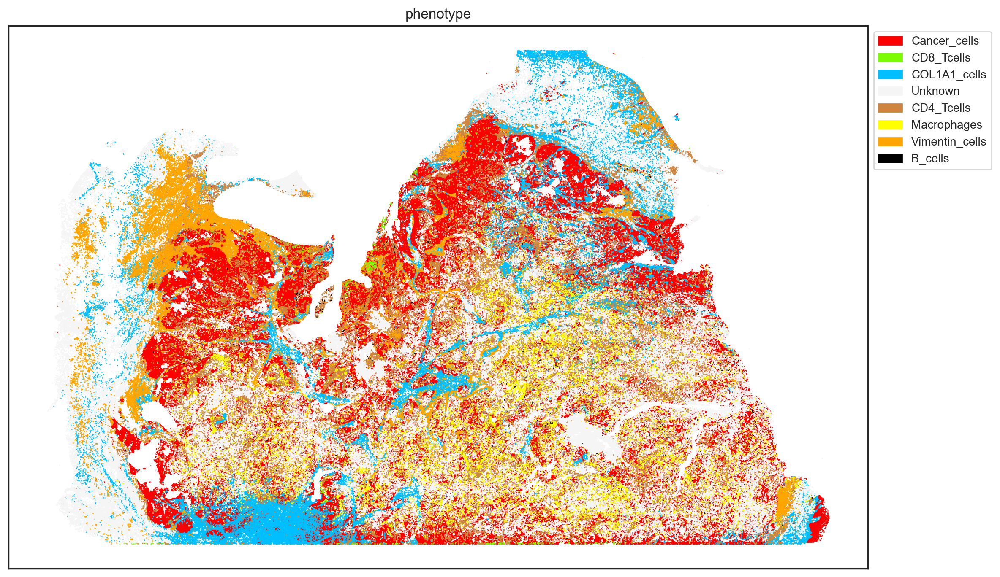

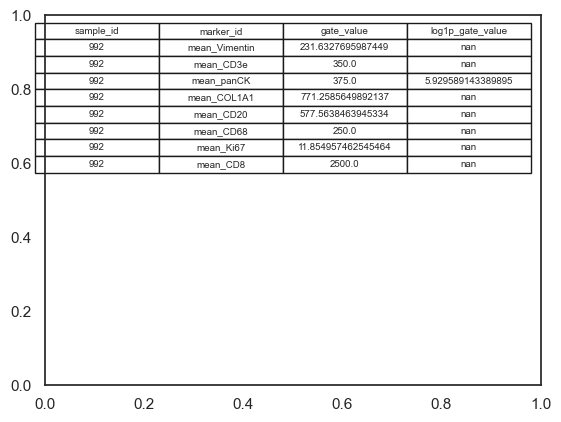

In [39]:
importlib.reload(utils)
utils.phenotype_with_gate_change(
    adata=adata,
    gates=gates,
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_panCK",
    new_gate = 375
)

2024-10-02 14:03:25.271 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 14:03:25.358 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 14:03:25.359 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 14:03:25.360 | INFO     | utils:phenotype_with_gate_change:305 - processed gate          marker       991
322  mean_panCK  5.303305
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:100: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill i

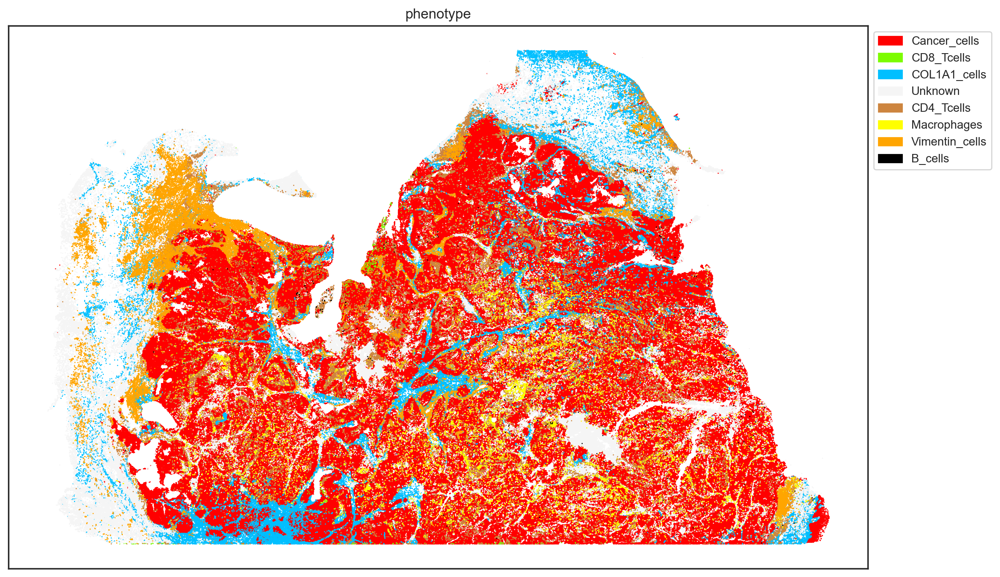

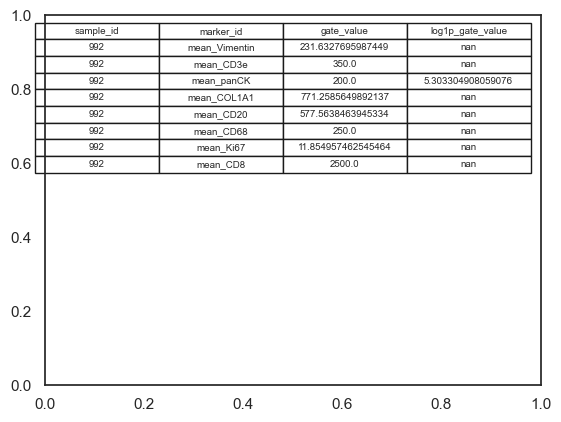

In [40]:
importlib.reload(utils)
utils.phenotype_with_gate_change(
    adata=adata,
    gates=gates,
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_panCK",
    new_gate = 200
)

2024-10-02 14:14:36.250 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 14:14:36.908 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 14:14:36.915 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 14:14:36.919 | INFO     | utils:phenotype_with_gate_change:305 - processed gate        marker       991
2  mean_panCK  5.303305
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:100: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is de

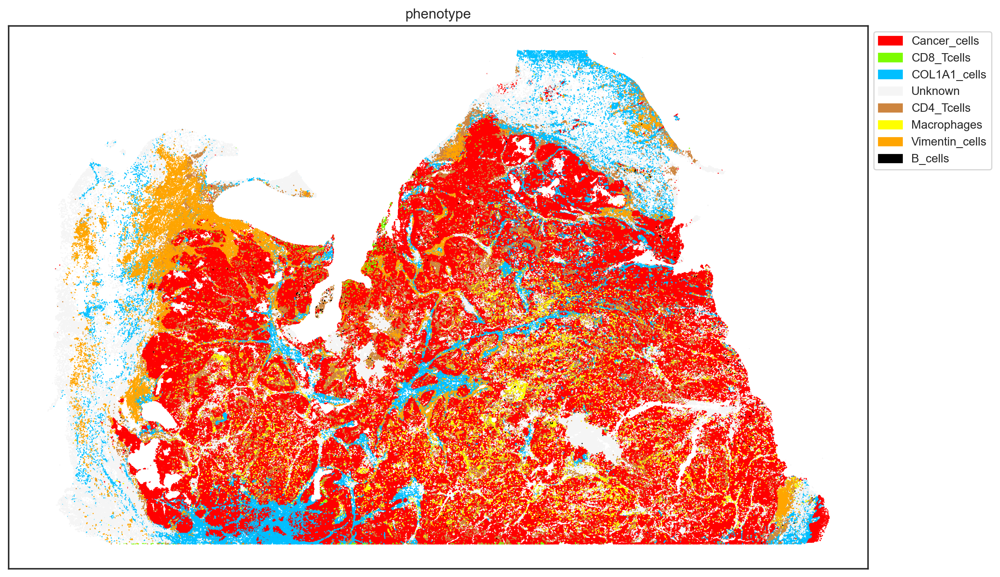

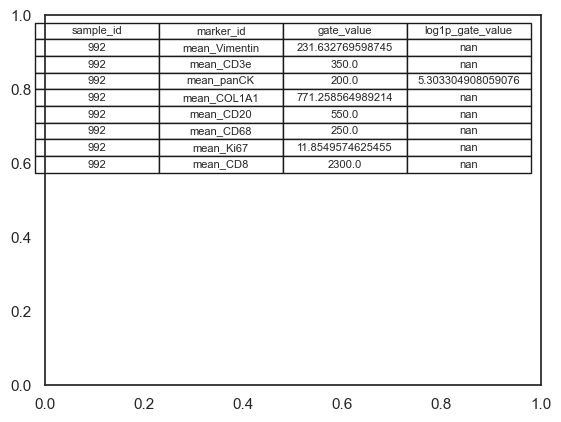

In [43]:
importlib.reload(utils)
path_to_gates = "../data/phenotyping/20241002_1413_992_gates.csv"

utils.phenotype_with_gate_change(
    adata=adata,
    gates=pd.read_csv(path_to_gates),
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="991",
    marker = "mean_panCK",
    new_gate = 200
)

2024-10-02 14:17:00.470 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----


2024-10-02 14:17:00.595 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 14:17:00.598 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 14:17:00.600 | INFO     | utils:phenotype_with_gate_change:305 - processed gate        marker       992
2  mean_panCK  5.525453
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.se

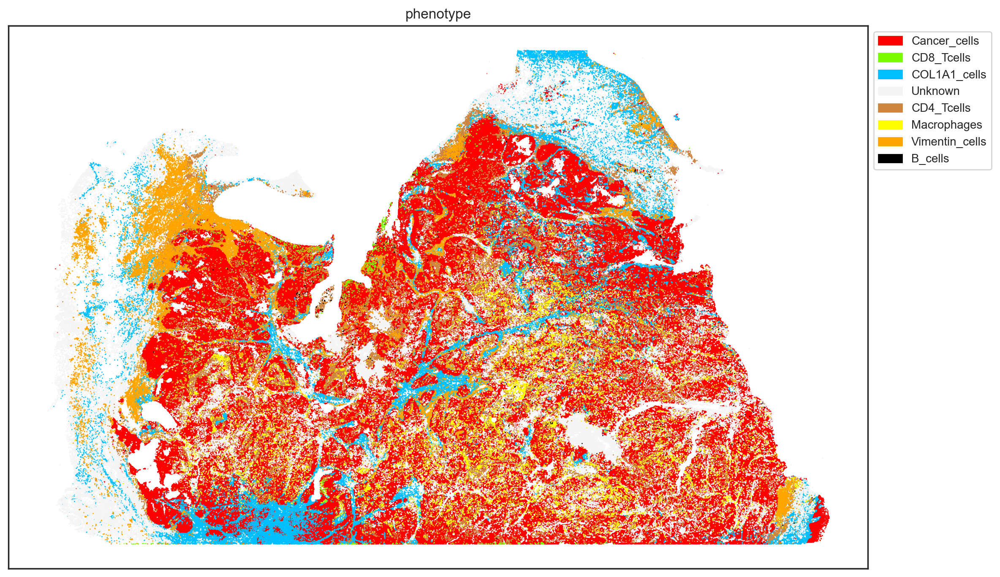

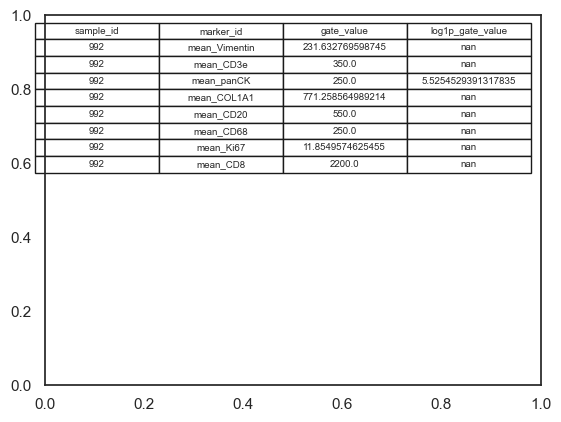

In [44]:
importlib.reload(utils)
path_to_gates = "../data/phenotyping/20241002_1416_992_gates.csv"

utils.phenotype_with_gate_change(
    adata=adata,
    gates=pd.read_csv(path_to_gates),
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="992",
    marker = "mean_panCK",
    new_gate = 250
)

2024-10-02 14:18:25.044 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----
2024-10-02 14:18:25.136 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 14:18:25.141 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 14:18:25.144 | INFO     | utils:phenotype_with_gate_change:305 - processed gate      marker       992
7  mean_CD8  7.751905
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprec

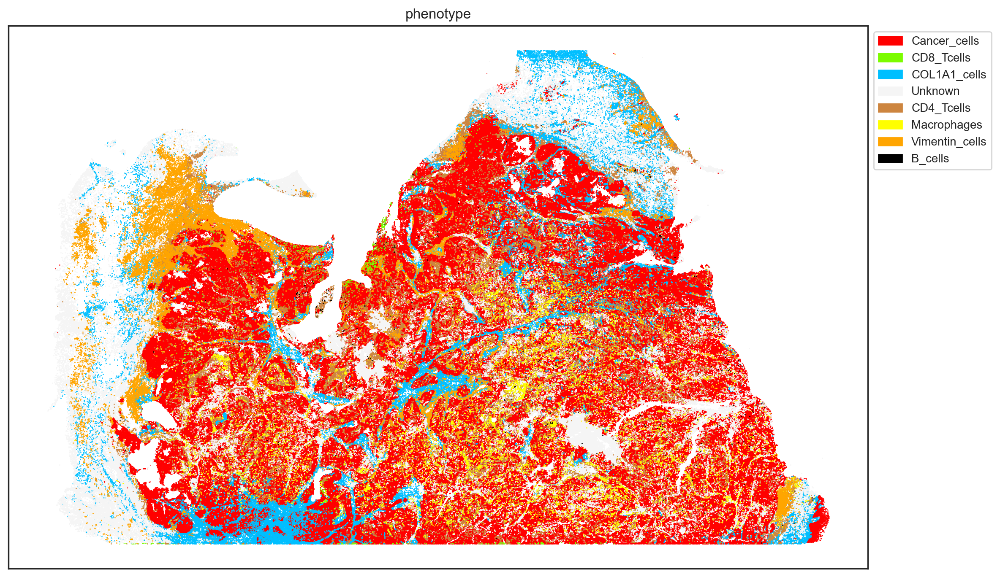

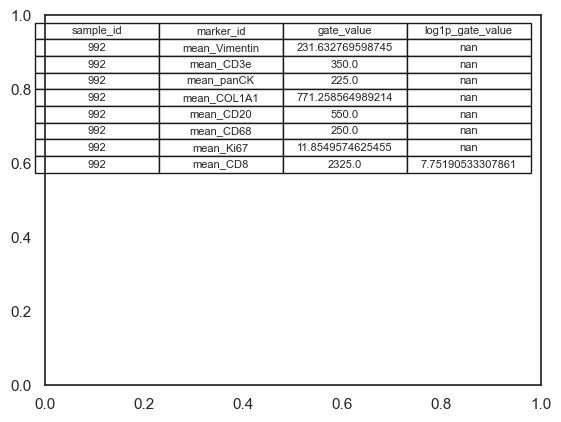

In [45]:
importlib.reload(utils)
path_to_gates = "../data/phenotyping/20241002_1416_992_gates.csv"

utils.phenotype_with_gate_change(
    adata=adata,
    gates=pd.read_csv(path_to_gates),
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="992",
    marker = "mean_CD8",
    new_gate = 2325
)

2024-10-02 14:37:34.717 | INFO     | utils:phenotype_with_gate_change:296 -  ---- phenotype_with_gate_change : version number 1.0.0 ----


2024-10-02 14:37:34.844 | INFO     | utils:process_gates_for_sm:87 -  ---- process_gates_for_sm : version number 1.2.0 ----
/Users/jnimoca/Jose_BI/P26_DA/scripts/utils.py:94: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-10-02 14:37:34.846 | INFO     | utils:process_gates_for_sm:96 -  ---- process_gates_for_sm is done, took 0s  ----
2024-10-02 14:37:34.848 | INFO     | utils:phenotype_with_gate_change:305 - processed gate      marker       992
7  mean_CD8  7.751905
/opt/homebrew/Caskroom/mambaforge/base/envs/scimap/lib/python3.10/site-packages/scimap/preprocessing/rescale.py:105: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_op

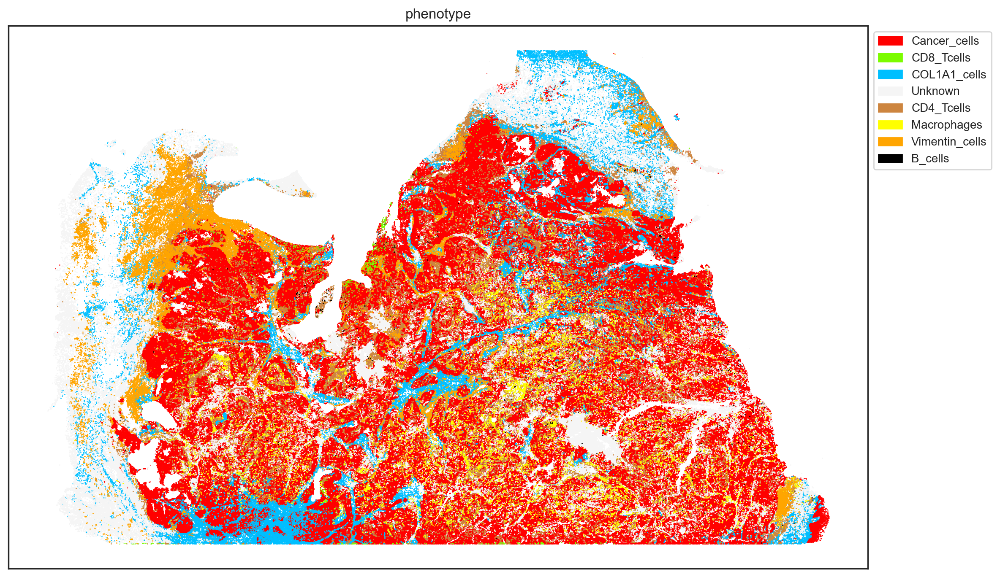

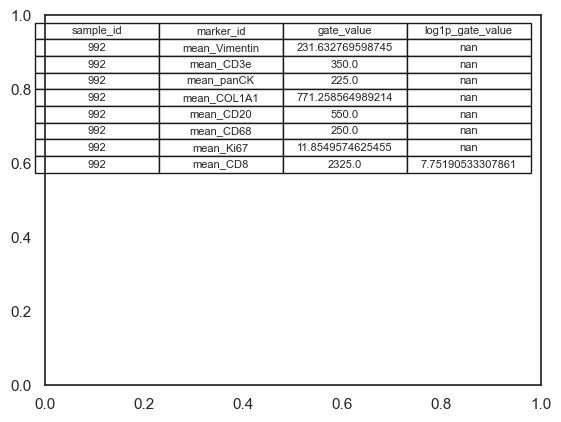

2024-10-02 14:37:56.621 | INFO     | utils:phenotype_with_gate_change:331 -  phenotyping saved in adata object


In [47]:
importlib.reload(utils)
path_to_gates = "../data/phenotyping/20241002_1436_992_gates_final.csv"

adata = utils.phenotype_with_gate_change(
    adata=adata,
    gates=pd.read_csv(path_to_gates),
    phenotype_matrix=pd.read_csv(path_to_phenotype_matrix),
    sample_id="992",
    marker = "mean_CD8",
    new_gate = 2325,
    adata_in_place=True,
)

In [48]:
adata.write(f"../data/processed/20241002_992_phenotyped.h5ad")